### Train data vars

In [1]:
import numpy as np
from datasets import load_dataset

datasets = load_dataset("text", data_files={"train": "./train_noestart.txt"})
print(datasets['train'][0])
myTrainDataset = list(datasets['train'][:].values())[0]
print(myTrainDataset[0])

train_lens = [len(seq.split()) for seq in myTrainDataset]
train_ecodes_idxs = [[seq.split(' ')[1],idx] for idx,seq in enumerate(myTrainDataset)]
train_ecode_idxs_dict = {} # dictionary of ecode to list of idxs
train_ecode_set = set([seq.split(' ')[1] for seq in myTrainDataset]) # 847
for item in train_ecodes_idxs:
    ecode = item[0]
    idx = item[1]
    if ecode not in train_ecode_idxs_dict:
        train_ecode_idxs_dict[ecode] = [idx]
    else:
        train_ecode_idxs_dict[ecode].append(idx)

# Sort dictionary by number of sequences
train_ecode_idxs_dict = {k:v for k,v in sorted(train_ecode_idxs_dict.items(), key=lambda item:len(item[1]),reverse=True)}

Using custom data configuration default-266043765068005e
Reusing dataset text (/home/dracoglacius/.cache/huggingface/datasets/text/default-266043765068005e/0.0.0/e16f44aa1b321ece1f87b07977cc5d70be93d69b20486d6dacd62e12cf25c9a5)


{'text': '<START> E880.9 <DSTART> 808.44 924.8 920 916 820.8 812.01 807.02 801.01 <PSTART> 81.52 79.31 <END>'}
<START> E880.9 <DSTART> 808.44 924.8 920 916 820.8 812.01 807.02 801.01 <PSTART> 81.52 79.31 <END>


### Train data embeddings: (1007614, 4, 768) first/last/second-last/meanpooled token embeds from last hidden state

In [2]:
all_train_embeds = np.memmap('/home/dracoglacius/StemmlerProject/MIke_GPT2/WordBBPEModels/8_24_Word_Lvl_GPT2/all_4_combined_embeds_trainWed_Jan_26_21:41:42_2022.npy',dtype='float32',mode='r',shape=(1007614,4,768))
print(f"Train embed shape: {(all_train_embeds.shape)}")

Train embed shape: (1007614, 4, 768)


### Special Token Embeddings: (250000,4,768)

In [4]:
special_token_embeds = np.memmap('/home/dracoglacius/StemmlerProject/MIke_GPT2/WordBBPEModels/8_24_Word_Lvl_GPT2/special_tokens_embeds_train.npy',dtype='float32',mode='r',shape=(250000,4,768))
print(f"special_token_embeds shape: {(special_token_embeds.shape)}")

special_token_embeds shape: (250000, 4, 768)


### Mapping ecode 'E885.9' to train embeddings for analysis

In [4]:
len(train_ecode_idxs_dict['E885.9']) # 120040

# build memmap array for the embeddings
E8859_train_4_embeds = np.memmap('/home/dracoglacius/StemmlerProject/MIke_GPT2/WordBBPEModels/8_24_Word_Lvl_GPT2/E885.9_train_4_embeds.npy', dtype='float32', mode='r', shape=(len(train_ecode_idxs_dict['E885.9']),4,768))
"""
for idx, embed_idx in enumerate(train_ecode_idxs_dict['E885.9']):
    E8859_train_4_embeds[idx,:,:] = all_train_embeds[embed_idx]

E8859_train_4_embeds.shape # (120040, 4, 768) 
"""

"\nfor idx, embed_idx in enumerate(train_ecode_idxs_dict['E885.9']):\n    E8859_train_4_embeds[idx,:,:] = all_train_embeds[embed_idx]\n\nE8859_train_4_embeds.shape # (120040, 4, 768) \n"

### Gen data vars

In [3]:
gen_dataset = np.load('/home/dracoglacius/StemmlerProject/MIke_GPT2/WordBBPEModels/8_24_Word_Lvl_GPT2/TopP_0.9_wordlvl_ft_gen_seqs_nat0k_500k.npy', mmap_mode='r')
natgen_ecodes_idx = ([seq.split(' ')[1],idx] for idx,seq in enumerate(gen_dataset))
natgen_lens = [len(seq.split()) for seq in gen_dataset]
natgen_ecode_set = set([seq.split(' ')[1] for seq in gen_dataset])
print(len(natgen_ecode_set)) # 749, close to train ecode set len of 847

natgen_ecode_idxs_dict = {}
for item in natgen_ecodes_idx:
    ecode = item[0]
    idx = item[1]
    if ecode not in natgen_ecode_idxs_dict:
        natgen_ecode_idxs_dict[ecode] = [idx]
    else:
        natgen_ecode_idxs_dict[ecode].append(idx)
        
natgen_ecode_idxs = {k:v for k,v in sorted(natgen_ecode_idxs_dict.items(), key=lambda item:len(item[1]),reverse=True)}

749


In [74]:
# Find longest/shortest length gen seq with specific ecode
temp = natgen_ecode_idxs['E885.9']
longest, shortest = float('-inf'), float('inf')
for idx in temp:
    longest = max(longest, natgen_lens[idx])
    shortest = min(shortest,natgen_lens[idx])
print(f"Longest: {longest}\nShortest: {shortest}")

Longest: 175
Shortest: 6


In [82]:
longest, l_idx = float('-inf'), None
for idx in temp:
    if natgen_lens[idx] > longest:
        longest = natgen_lens[idx]
        l_idx = idx
print(f"Longest: {longest}\nIdx: {l_idx}")

Longest: 175
Idx: 57088


In [83]:
gen_dataset[l_idx]

'<START> E885.9 <DSTART> 824.6 <PSTART> 88.28 87.49 89.52 79.36 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 87.49 

In [15]:
sample_idx = natgen_ecode_idxs['E885.9'][999]
print(sample_idx)
gen_dataset[sample_idx]

8381


'<START> E885.9 <DSTART> 923.11 910.0 805.02 805.01 <PSTART> <UNK> <END>'

### Gen data embeddings: (500000, 4, 768) first/last/second-last/meanpooled token embeds from last hidden state

In [12]:
all_gen_embeds = np.memmap('/home/dracoglacius/StemmlerProject/MIke_GPT2/WordBBPEModels/8_24_Word_Lvl_GPT2/all_4_combined_embeds_gen.npy',dtype='float32',mode='r', shape=(500000,4,768))
print(f"Gen embeds shape: {(all_gen_embeds.shape)}")

Gen embeds shape: (500000, 4, 768)


### Mapping ecode 'E885.9' to gen embeddings for analysis

In [13]:
len(natgen_ecode_idxs_dict['E885.9']) # 59381

# build memmap array for the gen embeddings
E8859_gen_4_embeds = np.memmap('/home/dracoglacius/StemmlerProject/MIke_GPT2/WordBBPEModels/8_24_Word_Lvl_GPT2/E885.9_gen_4_embeds.npy', dtype='float32', mode='r', shape=(len(natgen_ecode_idxs_dict['E885.9']),4,768))

""" Commented because data already created
for idx, embed_idx in enumerate(natgen_ecode_idxs_dict['E885.9']):
    E8859_gen_4_embeds[idx,:,:] = all_gen_embeds[embed_idx]
"""
E8859_gen_4_embeds.shape # (59381, 4, 768)


(59381, 4, 768)

In [105]:
E8859_gen_4_embeds[:,0,:][:5000].shape

(5000, 768)

### Compute pairwise cosine similarity for first \<START\> token of last hidden state embedding

In [38]:
from sklearn.metrics.pairwise import cosine_similarity

# allocate memmap array for these results
E8859_gentrain_cossims = np.memmap('E8859_traingen_cossims.npy', dtype='float32', mode='r+', shape=(10000,10000))
E8859_gentrain_cossims[:] = cosine_similarity(E8859_gen_4_embeds[:,3,:][:10000],E8859_train_4_embeds[:,3,:][:10000])

In [39]:
E8859_gen_4_embeds[:,3,:][5].shape

(768,)

In [107]:
E8859_gentrain_cossims[60][:200] # all <start> token embed cos-sim are essentially identical

memmap([0.99999946, 0.99999946, 0.99999946, 0.9999995 , 0.99999946,
        0.9999995 , 0.9999995 , 0.9999995 , 0.99999946, 0.99999946,
        0.9999995 , 0.9999995 , 0.99999946, 0.99999946, 0.99999946,
        0.99999946, 0.99999946, 0.99999946, 0.99999946, 0.99999946,
        0.99999946, 0.99999946, 0.99999946, 0.99999946, 0.99999946,
        0.99999946, 0.99999946, 0.9999995 , 0.99999946, 0.99999946,
        0.9999995 , 0.99999946, 0.9999995 , 0.99999946, 0.99999946,
        0.99999946, 0.99999946, 0.99999946, 0.9999995 , 0.99999946,
        0.99999946, 0.99999946, 0.99999946, 0.99999946, 0.99999946,
        0.99999946, 0.9999995 , 0.99999946, 0.9999995 , 0.99999946,
        0.99999946, 0.99999946, 0.99999946, 0.99999946, 0.99999946,
        0.99999946, 0.99999946, 0.9999995 , 0.99999946, 0.99999946,
        0.99999946, 0.99999946, 0.99999946, 0.99999946, 0.9999995 ,
        0.99999946, 0.99999946, 0.99999946, 0.9999995 , 0.99999946,
        0.99999946, 0.99999946, 0.9999995 , 0.99

In [141]:
E8859_gentrain_cossims[60][:200] # Same for <end> token embeddings

memmap([0.99948883, 0.9996401 , 0.99841   , 0.999573  , 0.99963605,
        0.999501  , 0.99958986, 0.99969745, 0.9995338 , 0.9993162 ,
        0.9996691 , 0.9997048 , 0.9999066 , 0.99946284, 0.99909544,
        0.9993998 , 0.9996784 , 0.9996476 , 0.9997066 , 0.9993611 ,
        0.99969435, 0.9994939 , 0.9993114 , 0.9993671 , 0.9994693 ,
        0.9995409 , 0.99969655, 1.0000002 , 0.9987232 , 0.9995982 ,
        0.9997808 , 0.9994849 , 0.9995493 , 0.99916667, 0.99797267,
        0.99957097, 0.99947774, 0.99922335, 0.9994948 , 0.99932563,
        0.99961376, 0.9997119 , 0.9994394 , 0.999212  , 0.9987924 ,
        0.9998293 , 0.99912655, 0.9996209 , 0.9992759 , 0.99979675,
        0.99912965, 0.9996839 , 0.9996592 , 0.99917954, 0.9989733 ,
        0.99960303, 0.9995891 , 0.9997357 , 0.9997736 , 0.99944305,
        0.99971914, 0.999678  , 0.9994688 , 0.99786043, 0.9984465 ,
        0.9981607 , 0.9995625 , 0.99953985, 0.99959314, 0.99978805,
        0.99853694, 0.9996622 , 0.99976933, 0.99

In [109]:
E8859_gentrain_cossims[60][:200] # meanpooled embed cos-sims

memmap([ 0.8166301 ,  0.3341926 ,  0.3207725 ,  0.85692364,  0.439889  ,
         0.7535001 ,  0.9020702 ,  0.97504026,  0.5777922 ,  0.62884164,
         0.32585478,  0.85959154,  0.91692144,  0.6034972 ,  0.80812216,
         0.03764319,  0.7313168 ,  0.81985986,  0.3111434 ,  0.5827827 ,
         0.3511801 ,  0.6137702 ,  0.95939994,  0.85726357,  0.6493141 ,
         0.81528145,  0.60318196,  0.9999999 ,  0.15442465,  0.42192295,
         0.97515297,  0.11467111,  0.51224655,  0.14791542,  0.91828084,
         0.81969815,  0.75999755, -0.13904104,  0.5163427 ,  0.59393954,
         0.6184384 ,  0.8043873 ,  0.9350349 ,  0.29260316,  0.76964283,
         0.24746297,  0.89865994,  0.5505721 ,  0.24566254,  0.9668814 ,
        -0.22860394,  0.6862594 , -0.3329212 ,  0.5034228 ,  0.95990527,
         0.8419006 ,  0.7727058 ,  0.64266235,  0.89901626,  0.34783274,
         0.73810196,  0.8097477 ,  0.4743142 ,  0.77191794,  0.00896627,
         0.2657308 ,  0.78789186,  0.9481617 ,  0.5

In [ ]:
E8859_gentrain_cossims[60][:200] # second to last word embedding shows variation

### Compute Lev Distance 

In [17]:
from Levenshtein import distance as LevDist

# plot cos-sim vs L-distance
E8859_train_idxs = train_ecode_idxs_dict['E885.9'][:10000]
E8859_gen_idxs = natgen_ecode_idxs_dict['E885.9'][:10000]

lev_dist_10k10k_E8859 = np.memmap('lev_dist_10k10k_E8859', dtype='float32', mode='r', shape=(10000,10000))
"""
for i,gen_idx in enumerate(E8859_gen_idxs):
    for j,train_idx in enumerate(E8859_train_idxs):
        max_len = max(len(gen_dataset[gen_idx]),len(myTrainDataset[train_idx]))
        lev_dist_10k10k_E8859[i][j] = LevDist(gen_dataset[gen_idx],myTrainDataset[train_idx]) / max_len
"""
 

'\nfor i,gen_idx in enumerate(E8859_gen_idxs):\n    for j,train_idx in enumerate(E8859_train_idxs):\n        max_len = max(len(gen_dataset[gen_idx]),len(myTrainDataset[train_idx]))\n        lev_dist_10k10k_E8859[i][j] = LevDist(gen_dataset[gen_idx],myTrainDataset[train_idx]) / max_len\n'

In [18]:
lev_dist_10k10k_E8859[999][:50]

memmap([0.32394367, 0.4225352 , 0.2535211 , 0.3802817 , 0.32394367,
        0.3802817 , 0.36619717, 0.30985916, 0.46478873, 0.6802326 ,
        0.36619717, 0.36619717, 0.35211268, 0.50574714, 0.4903846 ,
        0.26760563, 0.43243244, 0.45070422, 0.23943663, 0.2535211 ,
        0.4225352 , 0.47887325, 0.23943663, 0.32394367, 0.46478873,
        0.45070422, 0.54      , 0.29577464, 0.33802816, 0.46478873,
        0.28169015, 0.51724136, 0.3802817 , 0.47887325, 0.4225352 ,
        0.45070422, 0.45070422, 0.45070422, 0.29577464, 0.42708334,
        0.47887325, 0.29577464, 0.38709676, 0.28169015, 0.35211268,
        0.29577464, 0.3802817 , 0.47126436, 0.36619717, 0.35211268],
       dtype=float32)

### Normalized absolute length difference

In [19]:
abs_dist_10k10k_E8859 = np.memmap('abs_dist_10k10k_E8859', dtype='float32', mode='r', shape=(10000,10000))
"""
for i,gen_idx in enumerate(E8859_gen_idxs):
    for j,train_idx in enumerate(E8859_train_idxs):
        len_gen = len(gen_dataset[gen_idx])
        len_train = len(myTrainDataset[train_idx])
        abs_dist_10k10k_E8859[i][j] = abs(len_gen-len_train) / max(len_gen,len_train)
"""

'\nfor i,gen_idx in enumerate(E8859_gen_idxs):\n    for j,train_idx in enumerate(E8859_train_idxs):\n        len_gen = len(gen_dataset[gen_idx])\n        len_train = len(myTrainDataset[train_idx])\n        abs_dist_10k10k_E8859[i][j] = abs(len_gen-len_train) / max(len_gen,len_train)\n'

In [20]:
abs_dist_10k10k_E8859[999][:100]

memmap([0.1971831 , 0.01408451, 0.18309858, 0.29577464, 0.1971831 ,
        0.29577464, 0.28169015, 0.28169015, 0.23943663, 0.5872093 ,
        0.28169015, 0.28169015, 0.18309858, 0.18390805, 0.31730768,
        0.09859155, 0.04054054, 0.1971831 , 0.02816901, 0.12676056,
        0.11267605, 0.12676056, 0.2112676 , 0.1971831 , 0.11267605,
        0.1971831 , 0.29      , 0.28169015, 0.        , 0.1971831 ,
        0.28169015, 0.18390805, 0.28169015, 0.1971831 , 0.11267605,
        0.1971831 , 0.11267605, 0.05633803, 0.28169015, 0.26041666,
        0.2112676 , 0.1971831 , 0.23655914, 0.2112676 , 0.01408451,
        0.15492958, 0.36619717, 0.18390805, 0.28169015, 0.23943663,
        0.11267605, 0.09859155, 0.20224719, 0.04225352, 0.2112676 ,
        0.11267605, 0.02816901, 0.29577464, 0.3106796 , 0.06578948,
        0.1971831 , 0.1971831 , 0.3364486 , 0.2970297 , 0.26760563,
        0.1971831 , 0.11267605, 0.1971831 , 0.28169015, 0.        ,
        0.02816901, 0.07792208, 0.35211268, 0.09

### Train seq lengths (10k that will be used for plotting)

In [22]:
E8859_train_lens = [None]*10000
for idx,train_idx in enumerate(E8859_train_idxs):
    E8859_train_lens[idx] = train_lens[train_idx]

### Plots

In [23]:
lev_dist_10k10k_E8859[999][:].shape

(10000,)

In [41]:
import seaborn as sns
import pandas as pd

df_0 = pd.DataFrame({'trainLens':E8859_train_lens,'cosSim':E8859_gentrain_cossims[999][:],'levDist':lev_dist_10k10k_E8859[999][:],'absDist':abs_dist_10k10k_E8859[999][:]}) # E885.9 gen seq 999 (8381 idx in all gen data), train seqs 0:10000
print(df_0.shape) # (10000,4)
df_0.head()

(10000, 4)


,trainLens,cosSim,levDist,absDist
0,8,0.827171,0.323944,0.197183
1,10,0.538006,0.422535,0.014085
2,8,0.868111,0.253521,0.183099
3,7,0.584373,0.380282,0.295775
4,8,0.944743,0.323944,0.197183


In [43]:
df_0_melt = pd.melt(df_0,'trainLens')
df_0_melt.head(100)

,trainLens,variable,value
0,8,cosSim,0.827171
1,10,cosSim,0.538006
2,8,cosSim,0.868111
3,7,cosSim,0.584373
4,8,cosSim,0.944743
...,...,...,...
95,17,cosSim,-0.160247
96,25,cosSim,-0.416790
97,7,cosSim,0.534896
98,16,cosSim,-0.243899


[Text(0.5, 1.0, '<START> E885.9 <DSTART> 923.11 910.0 805.02 805.01 <PSTART> <UNK> <END>')]

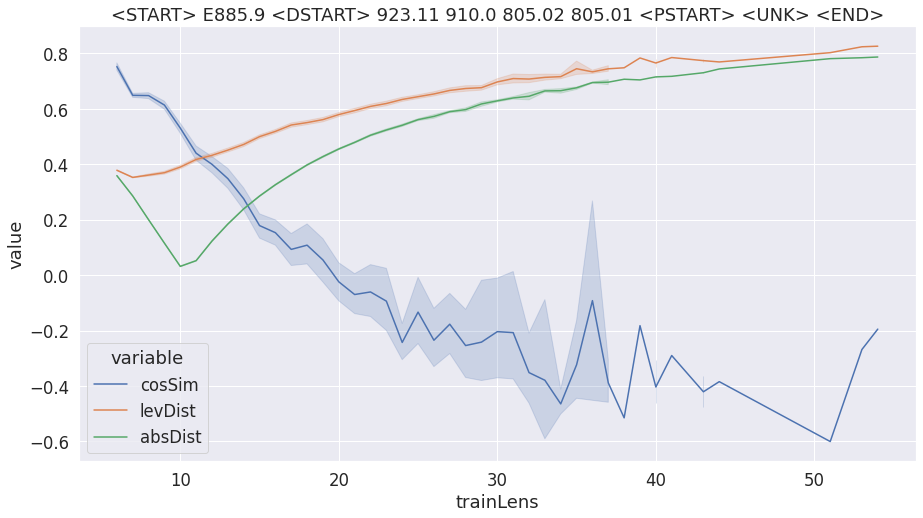

In [44]:
# Create plot from melted data

sns.set(rc = {'figure.figsize':(15,8)})
sns.set(font_scale=1.5)
sns.lineplot(x='trainLens', y='value', hue='variable', data=df_0_melt).set(title=gen_dataset[sample_idx]) # sample idx = 8381 in all gen dataset, 999 in E889.5 dataset

### PCA on embeddings (reduce dimensionality to before tSNE plot)

In [113]:
# retain number of dimensions that retain 95% of explained variance, not necessarily 50 
E8859_gen_4_embeds[:200,3,:].shape

(200, 768)

459


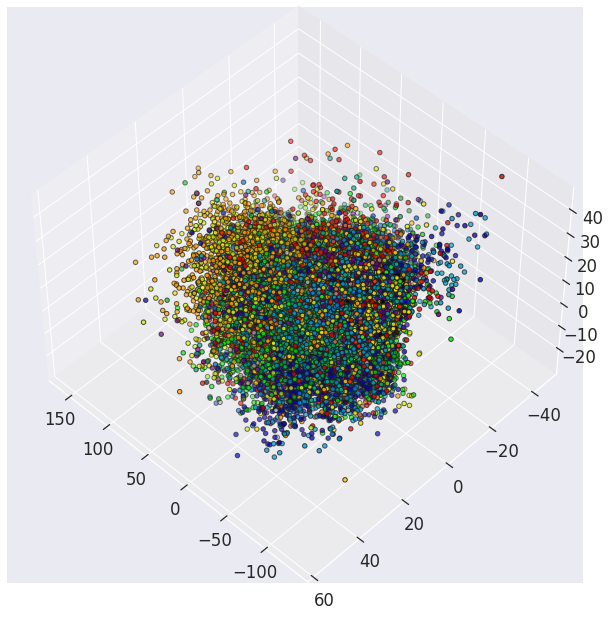

In [254]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from numpy.random import RandomState, SeedSequence, MT19937

# random state and figure setup
rstate = RandomState(MT19937(SeedSequence(123456789)))
fig = plt.figure(1, figsize=(15, 8))
plt.clf()
ax = Axes3D(fig, rect=[0, 0, 0.95, 1], elev=48, azim=134)

embeds_subset = all_gen_embeds[:50000,3,:] # 50000 mixed meanpooled embeddings of gen seqs (50000,768)

# get target ecodes of embedding subset which will be mapped to a dictionary
all_ecode_targets = list(train_ecode_set)
embeds_target_idxs = np.array([all_ecode_targets.index(seq.split()[1]) for seq in gen_dataset[:50000]]) # map ecode:int which will serve as target value for grouping clusters by
embeds_tgt_ecodes = [all_ecode_targets[idx] for idx in embeds_target_idxs] # ecode strings of the embeddings
#idx_label_dict = {idx:val for idx, val in enumerate(set(embeds_tgt_ecodes))}
idx_labels = [label for label in set(embeds_tgt_ecodes)]
embeds_targets = np.array([idx_labels.index(ecode) for ecode in [all_ecode_targets[idx] for idx in embeds_target_idxs]]) # all_ecode_targets

model_3D = PCA(n_components=3) # plot in 3D for now for initial visualization
model_95 = PCA(n_components=0.95,svd_solver='full') # n_components that explain variance >= 95% data
reduced_3D = model_3D.fit(embeds_subset).transform(embeds_subset)
reduced_095 = model_95.fit(embeds_subset).transform(embeds_subset)
reduced_095.shape # (50000, 4) 4 dims explain >=95% variance

print(len(set(embeds_targets))) # 459
ax.scatter(reduced_3D[:,0], reduced_3D[:,1], reduced_3D[:,2], c=embeds_targets, cmap=plt.cm.nipy_spectral, edgecolor="k", s=20)

### Same as above but using plotly: 1) meanpooled entire seq 2) meanpooled special tokens 3) meanpooled nonspecial tokens of train data

In [125]:
import plotly.express as px
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from numpy.random import RandomState, SeedSequence, MT19937
# commented out code was used for gen data instead of train data


# random state and figure setup
rstate = RandomState(MT19937(SeedSequence(27439284)))
#fig = plt.figure(1, figsize=(15, 8))
#plt.clf()
#ax = Axes3D(fig, rect=[0, 0, 0.95, 1], elev=48, azim=134)

embeds_subset = special_token_embeds[:50000,1,:] # 50000 mixed <DSTART> embeddings of train seqs (50000,768) (0:<START>, 1:<END>, 2:<DSTART>, 3:<PSTART>)
#embeds_subset = all_train_embeds[:50000,3,:] # 50000 mixed meanpooled embeddings of train seqs (50000,768)
#embeds_subset = all_gen_embeds[:50000,3,:] # 50000 mixed meanpooled embeddings of gen seqs (50000,768)

# get target ecodes of embedding subset which will be mapped to a dictionary
all_ecode_targets = list(train_ecode_set) 
embeds_target_idxs = np.array([all_ecode_targets.index(seq.split()[1]) for seq in myTrainDataset[:50000]]) # map ecode:int which will serve as target value for grouping clusters by
embeds_tgt_ecodes = [all_ecode_targets[idx] for idx in embeds_target_idxs] # ecode strings of the embeddings
#idx_label_dict = {idx:val for idx, val in enumerate(set(embeds_tgt_ecodes))}
idx_labels = [label for label in set(embeds_tgt_ecodes)]
embeds_targets = np.array([idx_labels.index(ecode) for ecode in [all_ecode_targets[idx] for idx in embeds_target_idxs]]) # all_ecode_targets

model_3D = PCA(n_components=3) # plot in 3D for now for initial visualization
model_95 = PCA(n_components=0.95,svd_solver='full') # n_components that explain variance >= 95% data
reduced_3D = model_3D.fit(embeds_subset).transform(embeds_subset)
reduced_095 = model_95.fit(embeds_subset).transform(embeds_subset)
print(reduced_095.shape) # (50000, 4) 4 dims explain >=95% variance

print(len(set(embeds_targets))) # 459
#ax.scatter(reduced_3D[:,0], reduced_3D[:,1], reduced_3D[:,2], c=embeds_targets, cmap=plt.cm.nipy_spectral, edgecolor="k", s=20)

(50000, 3)
459


### 3/10/22 Generate only points with specific ecode
### Heatmap coloring
### Generate whole-sequence based on median-length of train-ECODE
### Make sure grammar is good / keep track of number maligned/bad-length sequences (# generation steps)
### Keep track of gen-params/any paper-info
### Evaluating gen vs. non-gen data

In [59]:
from transformers import AutoTokenizer, AutoModelForCausalLM
from transformers import GPT2Model

datasets = load_dataset("text", data_files={"train": "./train_noestart.txt", "validation": "./valid_noestart.txt"})
datasets['train'][0]
myTrainDataset = list(datasets['train'][:].values())[0]
print(f"myTrainDataset[-1]: {myTrainDataset[-1]}")

NTDBGPT2_lm = AutoModelForCausalLM.from_pretrained('/home/dracoglacius/StemmlerProject/MIke_GPT2/WordBBPEModels/8_24_Word_Lvl_GPT2/FineTunedWordLvlGPT2/checkpoint-30880')
NTDBGPT2_tokenizer = AutoTokenizer.from_pretrained('/home/dracoglacius/StemmlerProject/MIke_GPT2/WordBBPEModels/8_24_Word_Lvl_GPT2/8_24_fast_word_lvl_tokenizer_noestart')
NTDBGPT2_embed = GPT2Model.from_pretrained('/home/dracoglacius/StemmlerProject/MIke_GPT2/WordBBPEModels/8_24_Word_Lvl_GPT2/FineTunedWordLvlGPT2/checkpoint-30880')

2022-03-16 14:32:50,958: Using custom data configuration default-0285baabe57c0fa9
2022-03-16 14:32:50,963: Reusing dataset text (/home/dracoglacius/.cache/huggingface/datasets/text/default-0285baabe57c0fa9/0.0.0/e16f44aa1b321ece1f87b07977cc5d70be93d69b20486d6dacd62e12cf25c9a5)
myTrainDataset[-1]: <START> E812.0 <DSTART> 922.1 873.42 854.06 <PSTART>  <END>


Some weights of the model checkpoint at /home/dracoglacius/StemmlerProject/MIke_GPT2/WordBBPEModels/8_24_Word_Lvl_GPT2/FineTunedWordLvlGPT2/checkpoint-30880 were not used when initializing GPT2Model: ['lm_head.weight']
- This IS expected if you are initializing GPT2Model from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing GPT2Model from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


In [43]:
# For each train ECODE, get average length and number of sequences in it

train_ecode_num_avg = {}
for seq in myTrainDataset:
    seq = seq.split()
    ecode = seq[1]
    if ecode not in train_ecode_num_avg:
        train_ecode_num_avg[ecode] = [1,len(seq)]
    else:
        train_ecode_num_avg[ecode][0] += 1
        train_ecode_num_avg[ecode][1] += len(seq)

for k,v in train_ecode_num_avg.items():
    v[1] //= v[0] # divide total length by num seqs for avg len

In [71]:
len(train_ecode_num_avg)
train_ecode_num_avg.items()
train_ecode_num_avg = {k:v for k,v in sorted(train_ecode_num_avg.items(), key=lambda item:item[1], reverse=True)} # sort via num seqs

# Selected ECODES
print(f"E8859:Fall from slipping NEC:Fall from other slipping, tripping, or stumbling: \n\tNum_seqs: {train_ecode_num_avg['E885.9'][0]} \n\tAvg_seq_len: {train_ecode_num_avg['E885.9'][1]}")
print(f"\nE8120:Mv collision NOS-driver:Other motor vehicle traffic accident involving collision with motor vehicle injuring driver of motor vehicle other than motorcycle: \n\tNum_seqs: {train_ecode_num_avg['E812.0'][0]} \n\tAvg_seq_len: {train_ecode_num_avg['E812.0'][1]}")
print(f"\nE966:Assault by cutting and piercing instrument:None: \n\tNum_seqs: {train_ecode_num_avg['E966.0'][0]} \n\tAvg_seq_len: {train_ecode_num_avg['E966.0'][1]}")

E8859:Fall from slipping NEC:Fall from other slipping, tripping, or stumbling: 
	Num_seqs: 120040 
	Avg_seq_len: 9

E8120:Mv collision NOS-driver:Other motor vehicle traffic accident involving collision with motor vehicle injuring driver of motor vehicle other than motorcycle: 
	Num_seqs: 68848 
	Avg_seq_len: 14

E966:Assault by cutting and piercing instrument:None: 
	Num_seqs: 31604 
	Avg_seq_len: 11


In [126]:
ecode_train_idxs = [idx for idx,seq in enumerate(myTrainDataset) if seq.split()[1]==SEARCH_ECODES[0]] # not needed... 
ecode_train_idxs[4999]

42003

In [127]:
# Searching train dataset for specific ecode

SEARCH_ECODES = ['E885.9','E812.0','E966.0']
SEARCH_ECODE_LENS = [train_ecode_num_avg[ecode][1] for ecode in SEARCH_ECODES]
#ecode_train_idxs = [idx for idx,seq in enumerate(myTrainDataset) if seq.split()[1]==SEARCH_ECODE[0]] # not needed... 

ecode_5kgen_dict = {ecode:[] for ecode in SEARCH_ECODES}

for ecode_key, seq_list_val in ecode_5kgen_dict.items():
    for counter in range(5000):
        input_seq = "<START> " + ecode_key + " <DSTART>"
        #print(f"Input_seq is: {input_seq}")
        seq_ids = NTDBGPT2_tokenizer.encode(input_seq, return_tensors='pt')
        out_wft = top_p_output_wft = NTDBGPT2_lm.generate(
            seq_ids, 
            do_sample=True,
            min_length=(train_ecode_num_avg[ecode_key][1])-1, # get avg seq length of train seq starting of ecode_key
            max_length=(train_ecode_num_avg[ecode_key][1])+1, 
            #top_p=0.9, 
            top_k=0,
            return_dict_in_generate=True,
            #output_scores=True,
            forced_eos_token_id=NTDBGPT2_tokenizer.eos_token_id,
            #repetition_penalty=3.0,
            #length_penalty=1.0,
            num_return_seqs=1
        )
        seq_list_val.append(NTDBGPT2_tokenizer.decode(out_wft[0][0]))


In [130]:
# save dictionary of ecode:5k_gen_seqs
np.save("ecode_5kgen_dict_3_16_22.npy", ecode_5kgen_dict)

In [195]:
# 3/17/22 - Give 50 translated seqs of each cluster, then plot train and adversarial vectors and check for differences
ecode_5kgen_dict['E885.9'][:50]

['<START> E885.9 <DSTART> 808.2 <PSTART> <UNK> <UNK> <UNK> <END>',
 '<START> E885.9 <DSTART> 852.02 805.01 <PSTART> <UNK> <UNK> <UNK> <END>',
 '<START> E885.9 <DSTART> 807.02 <PSTART> <UNK> <UNK> <UNK> <END>',
 '<START> E885.9 <DSTART> 873.42 820.21 <PSTART> 89.52 89.52 93.96 <END>',
 '<START> E885.9 <DSTART> 838.13 837.1 825.35 <PSTART> 79.87 79.08 <END>',
 '<START> E885.9 <DSTART> 802.30 802.0 <PSTART> 93.55 76.75 <END>',
 '<START> E885.9 <DSTART> 923 920 800.25 <PSTART> 87.03 88.38 <END>',
 '<START> E885.9 <DSTART> 852.22 852.02 853.02 807.01 805.07 <PSTART> <END>',
 '<START> E885.9 <DSTART> 920 916.0 913.0 820.21 812.01 <PSTART> <END>',
 '<START> E885.9 <DSTART> 823.22 <PSTART> <UNK> <UNK> <UNK> 79.16 <END>',
 '<START> E885.9 <DSTART> 924.01 920 852.20 852.00 851.00 <PSTART> <END>',
 '<START> E885.9 <DSTART> 844.8 <PSTART> 88.94 83.88 93.59 83.64 <END>',
 '<START> E885.9 <DSTART> 873.0 <PSTART> 87.03 88.76 93.52 88.38 <END>',
 '<START> E885.9 <DSTART> 808.43 <PSTART> <UNK> <UNK> <U

## Generate embeddings of gen seqs of 5k of each ecode

In [182]:
ecode_5kgen_dict.keys()
len(ecode_5kgen_dict['E885.9'])

5000

In [185]:
ecode_5kgen_embed_dict = {}
all_15k_gen_embeds = []
all_15k_gen_seqs = []

# Create a memory-mapped array to write desired embeddings to
for ecode_key in SEARCH_ECODES:
    for idx, seq in enumerate(ecode_5kgen_dict[ecode_key]):
        #filename = 'end_embed_gen_' + ecode_key + '_3_16_22.npy'  
        #end_gen_embeds = np.memmap(filename, dtype='float32', mode='w+', shape=(5000,1,768))
        #print(f"Seq is: {seq}")
        all_15k_gen_seqs.append(seq)
 
        input = NTDBGPT2_tokenizer(seq, return_tensors="pt")
        outputs = NTDBGPT2_embed(**input, output_hidden_states=True)
        last_embed = outputs[0][0][-1] # END embedding
        final_embed = last_embed.detach().numpy()
        #end_gen_embeds[idx-1] = final_embed
        all_15k_gen_embeds.append(final_embed)

        if idx == 1: print(f"The shape of the gen_embeds for single seq with ecode {ecode_key}: {final_embed.shape}")
        if idx % 5000 == 0:
            #end_gen_embeds.flush()
            print(f"{idx} sequences written to disk") # embeddings not sequences
print(f"The shape of all_15k_gen_embeds: {len(all_15k_gen_embeds)}")
print(f"The shape of all_15k_gen_seqs: {len(all_15k_gen_seqs)}")

0 sequences written to disk
The shape of the gen_embeds for single seq with ecode E885.9: (768,)
0 sequences written to disk
The shape of the gen_embeds for single seq with ecode E812.0: (768,)
0 sequences written to disk
The shape of the gen_embeds for single seq with ecode E966.0: (768,)
The shape of all_15k_gen_embeds: 15000


In [229]:
# Save the 15k gen seqs as numpy array of strings like for the train seqs
all_15k_gen_seqs = []

for ecode_key in SEARCH_ECODES:
    for idx, seq in enumerate(ecode_5kgen_dict[ecode_key]):
        all_15k_gen_seqs.append(seq)
print(f"The shape of all_15k_gen_seqs: {len(all_15k_gen_seqs)}")

# Save the seqs
temp = np.array(all_15k_gen_seqs)
np.save("15k_gen_seqs.npy", temp)

The shape of all_15k_gen_seqs: 15000


In [231]:
temp = np.load('/home/dracoglacius/StemmlerProject/MIke_GPT2/WordBBPEModels/8_24_Word_Lvl_GPT2/15k_gen_seqs.npy',allow_pickle=True,mmap_mode='r')
temp[0]

'<START> E885.9 <DSTART> 808.2 <PSTART> <UNK> <UNK> <UNK> <END>'

## Find first 5k embeddings of each train sequence via idx

In [227]:
ecode_5ktrain_embed_dict = {}
all_15k_train_embeds = []
all_15k_train_seqs = []
for ecode in SEARCH_ECODES:
    ecode_5ktrain_embed_dict[ecode] = []
    ecode_idxs = train_ecode_idxs_dict[ecode][:5000]
    print(f"Len ecode_idxs for ecode {ecode}: {len(ecode_idxs)}")
    print(f"Sample sequence whose <END> embedding is being stored is: {myTrainDataset[ecode_idxs[0]]}") # ECODE in this seq should match ECODE in above print
    for idx in ecode_idxs: # get respective embedding in train_embed_array made earlier
        ecode_5ktrain_embed_dict[ecode].append(special_token_embeds[idx][1])
        all_15k_train_embeds.append(special_token_embeds[idx][1])
        all_15k_train_seqs.append(myTrainDataset[ecode_idxs[0]])
    print(f"Len of ecode_5ktrain_embed_dict[{ecode}]: {len(ecode_5ktrain_embed_dict[ecode])}")
    print(f"Len of all_15k_train_embeds for {ecode}: {len(all_15k_train_embeds)}")
    print(f"Len of all_15k_train_seqs for {ecode}: {len(all_15k_train_seqs)}")

Len ecode_idxs for ecode E885.9: 5000
Sample sequence whose <END> embedding is being stored is: <START> E885.9 <DSTART> 853.00 873.0 <PSTART> 01.39 <END>
Len of ecode_5ktrain_embed_dict[E885.9]: 5000
Len of all_15k_train_embeds for E885.9: 5000
Len of all_15k_train_seqs for E885.9: 5000
Len ecode_idxs for ecode E812.0: 5000
Sample sequence whose <END> embedding is being stored is: <START> E812.0 <DSTART> 860.0 807.02 <PSTART> 93.52 88.01 87.41 <END>
Len of ecode_5ktrain_embed_dict[E812.0]: 5000
Len of all_15k_train_embeds for E812.0: 10000
Len of all_15k_train_seqs for E812.0: 10000
Len ecode_idxs for ecode E966.0: 5000
Sample sequence whose <END> embedding is being stored is: <START> E966.0 <DSTART> 879.2 876.0 <PSTART> 96.04 34.09 54.11 <END>
Len of ecode_5ktrain_embed_dict[E966.0]: 5000
Len of all_15k_train_embeds for E966.0: 15000
Len of all_15k_train_seqs for E966.0: 15000


In [228]:
temp = np.array(all_15k_train_seqs)
np.save("15k_train_seqs.npy", temp)
temp = np.load('/home/dracoglacius/StemmlerProject/MIke_GPT2/WordBBPEModels/8_24_Word_Lvl_GPT2/15k_train_seqs.npy',allow_pickle=True,mmap_mode='r')
temp[0]


'<START> E885.9 <DSTART> 853.00 873.0 <PSTART> 01.39 <END>'

## Run PCA and plotting of the 3 ecode train/gen embeddings

In [192]:
import plotly.express as px
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from numpy.random import RandomState, SeedSequence, MT19937
import icd9cms
import pandas as pd



rstate = RandomState(MT19937(SeedSequence(27439284)))

print(f"SEARCH_ECODES: {SEARCH_ECODES}")
all_15k_train_embeds, embeds_targets, myhoverdata = [], [], []

for label_idx,ecode in enumerate(SEARCH_ECODES):
    ecode_idxs = train_ecode_idxs_dict[ecode][:5000]

    for idx in ecode_idxs: # get respective embedding in train_embed_array made earlier
        embeds_targets.append(label_idx) # label of 0,1,2 corresponding to 3 ECODES which will be used to color PCA plot
        if ecode == 'E966.0':
            myhoverdata.append(icd9cms.search('E966'))
        else:
            myhoverdata.append(icd9cms.search(ecode))
        all_15k_train_embeds.append(special_token_embeds[idx][1])

    print(f"Len of all_15k_train_embeds: {len(all_15k_train_embeds)}") # should output 5-10-15k
    print(f"Len of embeds_targets: {len(embeds_targets)}") # should output 5-10-15k
    print(f"Len of myhoverdata: {len(myhoverdata)}") # should output 5-10-15k

for idx,icdstr in enumerate(myhoverdata):
    myhoverdata[idx] = str(icdstr)




model_3D = PCA(n_components=3) # plot in 3D for now for initial visualization
model_95 = PCA(n_components=0.95,svd_solver='full') # n_components that explain variance >= 95% data
reduced_3D = model_3D.fit(all_15k_train_embeds).transform(all_15k_train_embeds)
reduced_095 = model_95.fit(all_15k_train_embeds).transform(all_15k_train_embeds)
print(reduced_095.shape) # (15000, 3) 3 dims explain >=95% variance

print(len(set(embeds_targets))) # 3

mydata = {'x':reduced_3D[:,0],'y':reduced_3D[:,1],'z':reduced_3D[:,2],'color':embeds_targets,'icd9':myhoverdata}
mydf = pd.DataFrame(data=mydata)
mydf.head(10)


fig = px.scatter_3d(mydf, x='x', y='y', z='z',color='color',hover_data=['icd9'], width=1400, height=700, title=f'Train <END> Embeddings of {SEARCH_ECODES}')
fig.show() # <END> variance dim = 3

# Get mean_centroids of each cluster
train_mean_x_E8859 = np.mean(reduced_3D[:5000,0])
train_mean_y_E8859 = np.mean(reduced_3D[:5000,1])
train_mean_z_E8859 = np.mean(reduced_3D[:5000,2])
print(f"Mean train E8859 centroid: {(train_mean_x_E8859,train_mean_y_E8859,train_mean_z_E8859)}")

train_mean_x_E8120 = np.mean(reduced_3D[5000:10000,0])
train_mean_y_E8120 = np.mean(reduced_3D[5000:10000,1])
train_mean_z_E8120 = np.mean(reduced_3D[5000:10000,2])
print(f"Mean train E8120 centroid: {(train_mean_x_E8120,train_mean_y_E8120,train_mean_z_E8120)}")

train_mean_x_E9660 = np.mean(reduced_3D[10000:15000,0])
train_mean_y_E9660 = np.mean(reduced_3D[10000:15000,1])
train_mean_z_E9660 = np.mean(reduced_3D[10000:15000,2])
print(f"Mean train E9660 centroid: {(train_mean_x_E9660,train_mean_y_E9660,train_mean_z_E9660)}")

SEARCH_ECODES: ['E885.9', 'E812.0', 'E966.0']
Len of all_15k_train_embeds: 5000
Len of embeds_targets: 5000
Len of myhoverdata: 5000
Len of all_15k_train_embeds: 10000
Len of embeds_targets: 10000
Len of myhoverdata: 10000
Len of all_15k_train_embeds: 15000
Len of embeds_targets: 15000
Len of myhoverdata: 15000
(15000, 3)
3


Mean train E8859 centroid: (-2.215636132463361, 6.075232455683236, -1.2229069628404128)
Mean train E8120 centroid: (3.1912573955703634, -4.325171224462822, -3.3260006292744873)
Mean train E9660 centroid: (-0.9756212631070023, -1.7500612312204096, 4.548907592114911)


### Repeat above for generated sequences

In [260]:
rstate = RandomState(MT19937(SeedSequence(27439284)))

print(f"SEARCH_ECODES: {SEARCH_ECODES}")
embeds_targets, myhoverdata = [], []

for label_idx,ecode in enumerate(SEARCH_ECODES):
    #ecode_idxs = train_ecode_idxs_dict[ecode][:5000]
    start_idx = 0
    if label_idx == 0:
        #d2=np.load("/home/dracoglacius/StemmlerProject/MIke_GPT2/WordBBPEModels/8_24_Word_Lvl_GPT2/end_embed_gen_E885.9_3_16_22.npy",'rb')
        #all_15k_gen_embeds.extend(d2.item().get(ecode))
        #print d2.item().get('key2')
        start_idx = 0
    if label_idx == 1:
        #d2=np.load("/home/dracoglacius/StemmlerProject/MIke_GPT2/WordBBPEModels/8_24_Word_Lvl_GPT2/end_embed_gen_E812.0_3_16_22.npy",'rb')
        #all_15k_gen_embeds.extend(d2.item().get(ecode))
        #print d2.item().get('key2')
        start_idx = 5000
    if label_idx == 2:
        #d2=np.load("/home/dracoglacius/StemmlerProject/MIke_GPT2/WordBBPEModels/8_24_Word_Lvl_GPT2/end_embed_gen_E966.0_3_16_22.npy",'rb')
        #all_15k_gen_embeds.extend(d2.item().get(ecode))
        #print d2.item().get('key2')
        start_idx = 10000
    

    for embed in all_15k_gen_embeds[start_idx:start_idx+5000]: # get respective embedding in train_embed_array made earlier
        embeds_targets.append(label_idx) # label of 0,1,2 corresponding to 3 ECODES which will be used to color PCA plot
        if ecode == 'E966.0':
            myhoverdata.append(icd9cms.search('E966'))
        else:
            myhoverdata.append(icd9cms.search(ecode))

    print(f"Len of all_15k_gen_embeds: {len(all_15k_gen_embeds)}") # should output 5-10-15k
    print(f"Len of embeds_targets: {len(embeds_targets)}") # should output 5-10-15k
    print(f"Len of myhoverdata: {len(myhoverdata)}") # should output 5-10-15k

for idx,icdstr in enumerate(myhoverdata):
    myhoverdata[idx] = str(icdstr)




model_3D = PCA(n_components=3) # plot in 3D for now for initial visualization
model_95 = PCA(n_components=0.95,svd_solver='full') # n_components that explain variance >= 95% data
reduced_3D = model_3D.fit(all_15k_train_embeds).transform(all_15k_gen_embeds)
reduced_095 = model_95.fit(all_15k_train_embeds).transform(all_15k_gen_embeds)
print(reduced_095.shape) # (15000, 3) 3 dims explain >=95% variance

print(len(set(embeds_targets))) # 3

mydata = {'x':reduced_3D[:,0],'y':reduced_3D[:,1],'z':reduced_3D[:,2],'color':embeds_targets,'icd9':myhoverdata}
mydf = pd.DataFrame(data=mydata)
mydf.head(10)


fig = px.scatter_3d(mydf, x='x', y='y', z='z',color='color',hover_data=['icd9'], width=1400, height=700, title=f'Gen <END> Embeddings of {SEARCH_ECODES}')
fig.show() # <END> variance dim = 3

# Get mean_centroids of each cluster
gen_mean_x_E8859 = np.mean(reduced_3D[:5000,0])
gen_mean_y_E8859 = np.mean(reduced_3D[:5000,1])
gen_mean_z_E8859 = np.mean(reduced_3D[:5000,2])
print(f"Mean gen E8859 centroid: {(gen_mean_x_E8859,gen_mean_y_E8859,gen_mean_z_E8859)}")


gen_mean_x_E8120 = np.mean(reduced_3D[5000:10000,0])
gen_mean_y_E8120 = np.mean(reduced_3D[5000:10000,1])
gen_mean_z_E8120 = np.mean(reduced_3D[5000:10000,2])
print(f"Mean gen E8120 centroid: {(gen_mean_x_E8120,gen_mean_y_E8120,gen_mean_z_E8120)}")

gen_mean_x_E9660 = np.mean(reduced_3D[10000:15000,0])
gen_mean_y_E9660 = np.mean(reduced_3D[10000:15000,1])
gen_mean_z_E9660 = np.mean(reduced_3D[10000:15000,2])
print(f"Mean gen E9660 centroid: {(gen_mean_x_E9660,gen_mean_y_E9660,gen_mean_z_E9660)}")

# Use same eigenval/vec from train to plot gen


SEARCH_ECODES: ['E885.9', 'E812.0', 'E966.0']
Len of all_15k_gen_embeds: 15000
Len of embeds_targets: 5000
Len of myhoverdata: 5000
Len of all_15k_gen_embeds: 15000
Len of embeds_targets: 10000
Len of myhoverdata: 10000
Len of all_15k_gen_embeds: 15000
Len of embeds_targets: 15000
Len of myhoverdata: 15000
(15000, 3)
3


Mean gen E8859 centroid: (-2.5703790550303327, 6.708368922773909, -1.5894775653824316)
Mean gen E8120 centroid: (2.4952189416613777, -4.388890159512898, -4.062381121593069)
Mean gen E9660 centroid: (0.8832374684247203, -1.4915776321357987, 3.7921179230013977)


In [240]:
# Train mean centroid points
mean_train_E8859_point = np.array((train_mean_x_E8859,train_mean_y_E8859,train_mean_z_E8859))
mean_train_E8120_point = np.array((train_mean_x_E8120,train_mean_y_E8120,train_mean_z_E8120))
mean_train_E9660_point = np.array((train_mean_x_E9660,train_mean_y_E9660,train_mean_z_E9660))

# Gen mean centroid points
mean_gen_E8859_point = np.array((gen_mean_x_E8859,gen_mean_y_E8859,gen_mean_z_E8859))
mean_gen_E8120_point = np.array((gen_mean_x_E8120,gen_mean_y_E8120,gen_mean_z_E8120))
mean_gen_E9660_point = np.array((gen_mean_x_E9660,gen_mean_y_E9660,gen_mean_z_E9660))

In [ ]:
gen_mean_x_E8859 = np.mean(reduced_3D[:5000,0])
gen_mean_y_E8859 = np.mean(reduced_3D[:5000,1])
gen_mean_z_E8859 = np.mean(reduced_3D[:5000,2])

In [241]:
point_1 = np.array((0, 0, 0))
point_2 = np.array((3, 3, 3))
square = np.square(point_1 - point_2)
# Get the sum of the square
sum_square = np.sum(square)
point_1
reduced_3D[0]
distance = np.sqrt(sum_square)
print(distance)

5.196152422706632


In [275]:
E8859_PCA_idx_dists = {}
for idx, coord in enumerate(reduced_3D[:5000]): # 0-5k:E8859
    square = np.square(coord - mean_gen_E8859_point)
    sum_square = np.sum(square)
    distance = np.sqrt(sum_square)
    E8859_PCA_idx_dists[idx] = distance
E8859_PCA_idx_dists = dict(sorted(E8859_PCA_idx_dists.items(), key=lambda item:item[1], reverse=False))
E8859_PCA_idxs = list(E8859_PCA_idx_dists.keys())
E8859_PCA_dists = list(E8859_PCA_idx_dists.values())

bot_50_idxs_E8859 = E8859_PCA_idxs[-50:]
top_50_idxs_E8859 = E8859_PCA_idxs[:50]

E8120_PCA_idx_dists = {}
for idx, coord in enumerate(reduced_3D[5000:10000],5000): # 5-10k:E8120
    square = np.square(coord - mean_gen_E8120_point)
    sum_square = np.sum(square)
    distance = np.sqrt(sum_square)
    E8120_PCA_idx_dists[idx] = distance
E8120_PCA_idx_dists = dict(sorted(E8120_PCA_idx_dists.items(), key=lambda item:item[1], reverse=False))
E8120_PCA_idx_dists = list(E8120_PCA_idx_dists.keys())

bot_50_idxs_E8120 = E8120_PCA_idx_dists[-50:]
top_50_idxs_E8120 = E8120_PCA_idx_dists[:50]

E9660_PCA_idx_dists = {}
for idx, coord in enumerate(reduced_3D[10000:],10000): # 10k-15k:E9660
    square = np.square(coord - mean_gen_E9660_point)
    sum_square = np.sum(square)
    distance = np.sqrt(sum_square)
    E9660_PCA_idx_dists[idx] = distance
E9660_PCA_idx_dists = dict(sorted(E9660_PCA_idx_dists.items(), key=lambda item:item[1], reverse=False))
E9660_PCA_idx_dists = list(E9660_PCA_idx_dists.keys())

bot_50_idxs_E9660 = E9660_PCA_idx_dists[-50:]
top_50_idxs_E9660 = E9660_PCA_idx_dists[:50]
    

In [276]:
print(top_50_idxs_E8859)
print(bot_50_idxs_E8859)

print(top_50_idxs_E8120)
print(bot_50_idxs_E8120)

print(top_50_idxs_E9660)
print(bot_50_idxs_E9660)

[1214, 1035, 3474, 505, 617, 3575, 1872, 158, 1298, 4161, 1908, 640, 716, 2348, 1130, 4535, 352, 132, 4058, 1642, 2045, 1540, 2158, 3821, 4588, 2494, 2270, 1043, 2882, 1520, 1563, 3094, 3567, 3039, 1551, 1861, 832, 3511, 1448, 2032, 4944, 457, 1016, 2741, 4471, 1775, 1860, 4625, 1019, 4821]
[191, 4144, 2507, 1219, 3437, 26, 2584, 835, 1807, 719, 1818, 2575, 4999, 2157, 3329, 3367, 4722, 521, 3451, 2533, 4167, 2829, 4156, 256, 2748, 3589, 4352, 930, 4442, 4524, 4238, 4626, 2695, 1942, 3414, 199, 1597, 3957, 2035, 3959, 4326, 4953, 18, 1086, 3128, 1139, 1347, 931, 2403, 2441]
[9862, 8295, 7105, 6283, 9662, 6828, 8841, 9079, 7429, 7342, 8865, 7983, 8817, 9515, 9495, 5607, 5748, 6685, 6850, 6780, 7970, 9413, 6274, 8434, 8612, 9520, 8364, 9572, 7010, 8456, 8134, 8682, 8173, 5897, 9478, 6041, 6658, 9492, 7213, 7723, 6449, 6193, 9465, 5117, 7919, 6089, 8396, 8547, 5646, 8801]
[6032, 8342, 9929, 6690, 8160, 9368, 9362, 6910, 9381, 9991, 7477, 6423, 7474, 9069, 9150, 7611, 8917, 6433, 5441, 945

In [277]:
# Get top and bottom 50 gen_sequences then translate
top_50_seqs = bot_50_seqs = []
for counter, idx in enumerate(top_50_idxs_E8859):
    top_50_seqs.append(all_15k_gen_seqs[idx])
    if counter % 10 == 0: print(f"Top Sequence is: {all_15k_gen_seqs[idx]}, its distance from the mean is: {E8859_PCA_idx_dists[idx]}\n")

for counter, idx in enumerate(bot_50_idxs_E8859):
    bot_50_seqs.append(all_15k_gen_seqs[idx])
    if counter % 10 == 0: print(f"Bot Sequence is: {all_15k_gen_seqs[idx]}, its distance from the mean is: {E8859_PCA_idx_dists[idx]}\n")




Top Sequence is: <START> E885.9 <DSTART> 823.21 <PSTART> 88.01 99.18 88.38 99.04 <END>, its distance from the mean is: 0.3946973646264289

Top Sequence is: <START> E885.9 <DSTART> 924.11 916.0 910.0 853.06 852.06 <PSTART> <END>, its distance from the mean is: 0.8642767637878651

Top Sequence is: <START> E885.9 <DSTART> 823.82 <PSTART> 93.54 79.16 88.72 89.14 <END>, its distance from the mean is: 1.0275589417318138

Top Sequence is: <START> E885.9 <DSTART> 847.2 <PSTART> 88.76 87.41 88.38 88.01 <END>, its distance from the mean is: 1.1461764466472213

Top Sequence is: <START> E885.9 <DSTART> 850.11 873.0 921.1 873.63 <PSTART> <END>, its distance from the mean is: 1.2381755493870386

Bot Sequence is: <START> E885.9 <DSTART> 920 850.5 <PSTART> 88.26 87.44 88.26 <END>, its distance from the mean is: 22.51211132947225

Bot Sequence is: <START> E885.9 <DSTART> 920 850.11 <PSTART> 87.03 27.51 <END>, its distance from the mean is: 23.109113111186737

Bot Sequence is: <START> E885.9 <DSTART> 85

In [280]:
import pickle
# Translate top 50, bottom 50 sequences

# Load ICD9 dictionaries for sequence translations
dcode_dict_name = "dcode_dict.txt"
pcode_dict_name = "pcode_dict.txt"
dcode_dict_path = os.path.join(os.getcwd(), dcode_dict_name)
pcode_dict_path = os.path.join(os.getcwd(), pcode_dict_name)

with open(dcode_dict_path, "rb") as fp:   
    icd9_dcode_dict = pickle.load(fp)

with open(pcode_dict_path, "rb") as fp: 
    icd9_pcode_dict = pickle.load(fp)

# Translation functions
def translate_dpcode_seq(list_seq, pstart_idx, dcode_dict, pcode_dict):
    translation = []
    for dcode in list_seq[:pstart_idx]:
        dcode = re.sub('[.]', '', dcode)
        if dcode in dcode_dict:
            translation.append(dcode_dict[dcode])
    for pcode in list_seq[pstart_idx+1:]:
        pcode = re.sub('[.]', '', pcode)
        if pcode in pcode_dict:
            translation.append(pcode_dict[pcode])
    return translation

def remove_period_from_seq_and_translate(list_seq, translations, dcode_dict, pcode_dict): 
    if '<PSTART>' in list_seq:
        pstart_idx = list_seq.index('<PSTART>')
    else:
        pstart_idx = len(list_seq) - 1
    translation = translate_dpcode_seq(list_seq, pstart_idx, dcode_dict, pcode_dict)
    translations.append(translation)

my_translations = []
cleaned_datasetseq = [seq.split() for seq in top_50_seqs]
for seq in cleaned_datasetseq:
    my_translations.append(seq[1:-1])
    remove_period_from_seq_and_translate(seq, my_translations, icd9_dcode_dict, icd9_pcode_dict)


## End of new code, cell below connects to code before 3/10 meeting

In [10]:
len(embeds_tgt_ecodes)
embeds_tgt_ecodes[:5]
reduced_095.shape
reduced_3D.shape
type(reduced_3D) # numpy.ndarray

numpy.ndarray

In [7]:
from icd9cms.icd9 import search

temp = embeds_tgt_ecodes[0]
temp
search(temp)
myhoverdata = [search(ecode) for ecode in embeds_tgt_ecodes]
for idx,icdstr in enumerate(myhoverdata):
    myhoverdata[idx] = str(icdstr)
print(myhoverdata[:10])
print(embeds_tgt_ecodes[:10])
len(myhoverdata)

['E8809:Fall on stair/step NEC:Accidental fall on or from other stairs or steps', 'E8889:Fall NOS:Unspecified fall', 'E8121:Mv collision NOS-pasngr:Other motor vehicle traffic accident involving collision with motor vehicle injuring passenger in motor vehicle other than motorcycle', 'None', 'E9889:Undetermin circumst NOS:Injury by unspecified means, undetermined whether accidentally or purposely inflicted', 'None', 'E8147:Mv coll w pedest-pedest:Motor vehicle traffic accident involving collision with pedestrian injuring pedestrian', 'E8980:Burning bedclothes:Accident caused by burning bedclothes', 'E9600:Unarmed fight or brawl:Unarmed fight or brawl', 'E8191:Traffic acc NOS-pasngr:Motor vehicle traffic accident of unspecified nature injuring passenger in motor vehicle other than motorcycle']
['E880.9', 'E888.9', 'E812.1', 'E966.0', 'E988.9', 'E966.0', 'E814.7', 'E898.0', 'E960.0', 'E819.1']


50000

In [31]:
import pandas as pd
mydata = {'x':reduced_3D[:,0][:1000],'y':reduced_3D[:,1][:1000],'z':reduced_3D[:,2][:1000],'color':embeds_tgt_ecodes[:1000],'icd9':myhoverdata[:1000]}
mydf = pd.DataFrame(data=mydata)
mydf.head(10)

,x,y,z,color,icd9
0,-40.326412,-19.421907,13.455381,E880.9,E8809:Fall on stair/step NEC:Accidental fall o...
1,-89.102394,3.425610,10.260177,E888.9,E8889:Fall NOS:Unspecified fall
2,-53.608212,23.973560,10.258248,E812.1,E8121:Mv collision NOS-pasngr:Other motor vehi...
3,-0.710345,6.740499,8.940100,E966.0,None
4,-139.364990,-18.250404,7.105387,E988.9,E9889:Undetermin circumst NOS:Injury by unspec...
5,-21.959299,9.162989,7.417821,E966.0,None
6,-15.943323,-3.103502,-11.633636,E814.7,E8147:Mv coll w pedest-pedest:Motor vehicle tr...
7,47.633541,6.070271,7.883030,E898.0,E8980:Burning bedclothes:Accident caused by bu...
8,23.042118,2.750981,-6.351374,E960.0,E9600:Unarmed fight or brawl:Unarmed fight or ...
9,59.314903,10.075089,-1.651482,E819.1,E8191:Traffic acc NOS-pasngr:Motor vehicle tra...


In [26]:
# Check <START> duplicates

dup_df = mydf.duplicated(keep=False)
num_dup = dup_df.sum()
print(f"Number of duplicate points in <START> embeds: {num_dup}\n")
mydf.head(20)

Number of duplicate points in <START> embeds: 904



,x,y,z,color,icd9
0,0.075423,-0.000106,-9.872019e-08,E880.9,E8809:Fall on stair/step NEC:Accidental fall o...
1,0.075423,-0.000106,-9.872019e-08,E888.9,E8889:Fall NOS:Unspecified fall
2,0.075033,0.000495,-8.195639e-08,E812.1,E8121:Mv collision NOS-pasngr:Other motor vehi...
3,0.075423,-0.000106,-9.872019e-08,E966.0,None
4,0.075033,0.000495,-8.195639e-08,E988.9,E9889:Undetermin circumst NOS:Injury by unspec...
5,0.075423,-0.000106,-9.872019e-08,E966.0,None
6,0.075033,0.000495,-8.195639e-08,E814.7,E8147:Mv coll w pedest-pedest:Motor vehicle tr...
7,0.075423,-0.000106,-9.872019e-08,E898.0,E8980:Burning bedclothes:Accident caused by bu...
8,0.075423,-0.000106,-9.872019e-08,E960.0,E9600:Unarmed fight or brawl:Unarmed fight or ...
9,0.075423,-0.000106,-9.872019e-08,E819.1,E8191:Traffic acc NOS-pasngr:Motor vehicle tra...


In [7]:
fig = px.scatter_3d(mydf, x='x', y='y', z='z',color='color',hover_data=['icd9'], width=1400, height=700, title='<START> Embeddings') # hover_data=['myhover']
fig.show() # <START> embeddings variance dimension = 1

In [29]:
# Check <END> duplicates

dup_df = mydf.duplicated(keep=False)
num_dup = dup_df.sum()
print(f"Number of duplicate points in <END> embeds: {num_dup}\n")
mydf.head(20)

Number of duplicate points in <END> embeds: 12



,x,y,z,color,icd9
0,-5.382248,-1.193020,-1.391954,E880.9,E8809:Fall on stair/step NEC:Accidental fall o...
1,0.682235,-5.180511,2.279559,E888.9,E8889:Fall NOS:Unspecified fall
2,5.362926,-8.617140,1.200961,E812.1,E8121:Mv collision NOS-pasngr:Other motor vehi...
3,-4.505813,3.004441,4.836347,E966.0,None
4,-10.929646,-3.633702,1.100944,E988.9,E9889:Undetermin circumst NOS:Injury by unspec...
5,6.518695,-4.462368,3.353090,E966.0,None
6,2.720374,-7.872365,-0.228032,E814.7,E8147:Mv coll w pedest-pedest:Motor vehicle tr...
7,7.309816,14.486667,2.169050,E898.0,E8980:Burning bedclothes:Accident caused by bu...
8,16.615620,-6.379025,1.533413,E960.0,E9600:Unarmed fight or brawl:Unarmed fight or ...
9,14.241328,-7.827039,4.555352,E819.1,E8191:Traffic acc NOS-pasngr:Motor vehicle tra...


In [11]:
fig = px.scatter_3d(mydf, x='x', y='y', z='z',color='color',hover_data=['icd9'], width=1400, height=700, title='<END> Embeddings') # hover_data=['myhover']
fig.show() # <END> variance dim = 3

In [57]:
import icd9cms

icd9cms.search('E966')

E966:Assault by cutting and piercing instrument:None

In [22]:
# Check <DSTART> duplicates

dup_df = mydf.duplicated(keep=False)
num_dup = dup_df.sum()
print(f"Number of duplicate points in <DSTART> embeds: {num_dup}\n")
mydf.head(20)

Number of duplicate points in <DSTART> embeds: 887



,x,y,z,color,icd9
0,16.013752,-9.826765,2.191256,E880.9,E8809:Fall on stair/step NEC:Accidental fall o...
1,26.599279,-8.995929,4.713686,E888.9,E8889:Fall NOS:Unspecified fall
2,3.865318,-2.904754,-6.570373,E812.1,E8121:Mv collision NOS-pasngr:Other motor vehi...
3,-15.609134,27.834217,-7.815980,E966.0,None
4,-3.512504,-3.557063,4.672872,E988.9,E9889:Undetermin circumst NOS:Injury by unspec...
5,-15.609134,27.834217,-7.815980,E966.0,None
6,-2.610984,-3.109835,-5.000515,E814.7,E8147:Mv coll w pedest-pedest:Motor vehicle tr...
7,151.194687,49.141560,3.236960,E898.0,E8980:Burning bedclothes:Accident caused by bu...
8,7.865489,-6.939756,2.043160,E960.0,E9600:Unarmed fight or brawl:Unarmed fight or ...
9,-16.047691,-1.699084,-5.125550,E819.1,E8191:Traffic acc NOS-pasngr:Motor vehicle tra...


In [15]:
fig = px.scatter_3d(mydf, x='x', y='y', z='z',color='color',hover_data=['icd9'], width=1400, height=700, title='<DSTART> Embeddings') # hover_data=['myhover']
fig.show() # <DSTART> embeddings variance dimension = 3

"""
The <START> token embedding only embed one dimension to explain the variance. All the other special tokens needed 3 dimensions. 
The <PSTART> token seemed to explain the most and was able to cluster the ecodes into the same clusters that we saw last week. 
Interestingly, only the ecode information provided some initial clustering and since it needed 3 dimensions maybe ECODE is enough for initial grouping.
"""

In [32]:
# Check <PSTART> duplicates

dup_df = mydf.duplicated(keep=False)
num_dup = dup_df.sum()
print(f"Number of duplicate points in <PSTART> embeds: {num_dup}\n")
mydf.head(20)

Number of duplicate points in <PSTART> embeds: 31



,x,y,z,color,icd9
0,-40.326412,-19.421907,13.455381,E880.9,E8809:Fall on stair/step NEC:Accidental fall o...
1,-89.102394,3.425610,10.260177,E888.9,E8889:Fall NOS:Unspecified fall
2,-53.608212,23.973560,10.258248,E812.1,E8121:Mv collision NOS-pasngr:Other motor vehi...
3,-0.710345,6.740499,8.940100,E966.0,None
4,-139.364990,-18.250404,7.105387,E988.9,E9889:Undetermin circumst NOS:Injury by unspec...
5,-21.959299,9.162989,7.417821,E966.0,None
6,-15.943323,-3.103502,-11.633636,E814.7,E8147:Mv coll w pedest-pedest:Motor vehicle tr...
7,47.633541,6.070271,7.883030,E898.0,E8980:Burning bedclothes:Accident caused by bu...
8,23.042118,2.750981,-6.351374,E960.0,E9600:Unarmed fight or brawl:Unarmed fight or ...
9,59.314903,10.075089,-1.651482,E819.1,E8191:Traffic acc NOS-pasngr:Motor vehicle tra...


In [18]:
fig = px.scatter_3d(mydf, x='x', y='y', z='z',color='color',hover_data=['icd9'], width=1400, height=700, title='<PSTART> Embeddings') # hover_data=['myhover']
fig.show() # <PSTART> variance dim = 3

In [74]:
fig = px.scatter_3d(mydf, x='x', y='y', z='z',color='color',hover_data=['icd9'], width=1400, height=700, title='Meanpooled Sequences') # hover_data=['myhover']
fig.show()

In [79]:
# As above but for special token meanpooled embeddings of train data <START> <DSTART> <PSTART if present> <END>

both_meanpoolspecial_meanpooldpcode_embeds = np.memmap('/home/dracoglacius/StemmlerProject/MIke_GPT2/WordBBPEModels/8_24_Word_Lvl_GPT2/both_meanpoolspecial_meanpooldpcode_embeds_train.npy',dtype='float32',mode='r',shape=(250000, 2, 768))
print(f"Special/nonspecial embed shape: {(both_meanpoolspecial_meanpooldpcode_embeds.shape)}")

embeds_subset_special = both_meanpoolspecial_meanpooldpcode_embeds[:50000,0,:] # 50000 meanpooled special embeddings of train seqs (50000,768)

"""
# get target ecodes of embedding subset which will be mapped to a dictionary
all_ecode_targets = list(train_ecode_set) 
embeds_target_idxs = np.array([all_ecode_targets.index(seq.split()[1]) for seq in myTrainDataset[:50000]]) # map ecode:int which will serve as target value for grouping clusters by
embeds_tgt_ecodes = [all_ecode_targets[idx] for idx in embeds_target_idxs] # ecode strings of the embeddings
#idx_label_dict = {idx:val for idx, val in enumerate(set(embeds_tgt_ecodes))}
idx_labels = [label for label in set(embeds_tgt_ecodes)]
embeds_targets = np.array([idx_labels.index(ecode) for ecode in [all_ecode_targets[idx] for idx in embeds_target_idxs]]) # all_ecode_targets
"""

model_3D = PCA(n_components=3) # plot in 3D for now for initial visualization
model_95 = PCA(n_components=0.95,svd_solver='full') # n_components that explain variance >= 95% data
reduced_3D = model_3D.fit(embeds_subset_special).transform(embeds_subset_special)
reduced_095 = model_95.fit(embeds_subset_special).transform(embeds_subset_special)
print(reduced_095.shape) # (50000, 3) 3 dims explain >=95% variance

print(len(set(embeds_targets))) # 459

mydata = {'x':reduced_3D[:,0][:10000],'y':reduced_3D[:,1][:10000],'z':reduced_3D[:,2][:10000],'color':embeds_tgt_ecodes[:10000],'icd9':myhoverdata[:10000]}
mydf = pd.DataFrame(data=mydata)
mydf.head()

fig = px.scatter_3d(mydf, x='x', y='y', z='z',color='color',hover_data=['icd9'], width=1400, height=700, title='Meanpooled Special Tokens')
fig.show()

Special/nonspecial embed shape: (250000, 2, 768)
(50000, 3)
459


In [ ]:
from sklearn.cluster import DBSCAN

# graph special tokens alone
# compare k-means cluster to above
# DBSCAN - Euclidean distance - don't worry about soft cosine similarity
# DBSCAN has O(n.d) time complexity

In [81]:
search('E956')

E956:Suicide and self-inflicted injury by cutting and piercing instrument:None

In [66]:
# As above but for non-special token meanpooled embeddings of train data <START> <DSTART> <PSTART if present> <END>

both_meanpoolspecial_meanpooldpcode_embeds = np.memmap('/home/dracoglacius/StemmlerProject/MIke_GPT2/WordBBPEModels/8_24_Word_Lvl_GPT2/both_meanpoolspecial_meanpooldpcode_embeds_train.npy',dtype='float32',mode='r',shape=(250000, 2, 768))
print(f"Train nonspecial embed shape: {(both_meanpoolspecial_meanpooldpcode_embeds.shape)}")

embeds_subset_special = both_meanpoolspecial_meanpooldpcode_embeds[:50000,1,:] # 50000 meanpooled special embeddings of train seqs (50000,768)

"""
# get target ecodes of embedding subset which will be mapped to a dictionary
all_ecode_targets = list(train_ecode_set) 
embeds_target_idxs = np.array([all_ecode_targets.index(seq.split()[1]) for seq in myTrainDataset[:50000]]) # map ecode:int which will serve as target value for grouping clusters by
embeds_tgt_ecodes = [all_ecode_targets[idx] for idx in embeds_target_idxs] # ecode strings of the embeddings
#idx_label_dict = {idx:val for idx, val in enumerate(set(embeds_tgt_ecodes))}
idx_labels = [label for label in set(embeds_tgt_ecodes)]
embeds_targets = np.array([idx_labels.index(ecode) for ecode in [all_ecode_targets[idx] for idx in embeds_target_idxs]]) # all_ecode_targets
"""

model_3D = PCA(n_components=3) # plot in 3D for now for initial visualization
model_95 = PCA(n_components=0.95,svd_solver='full') # n_components that explain variance >= 95% data
reduced_3D = model_3D.fit(embeds_subset_special).transform(embeds_subset_special)
reduced_095 = model_95.fit(embeds_subset_special).transform(embeds_subset_special)
print(reduced_095.shape) # (50000, 4) 4 dims explain >=95% variance

print(len(set(embeds_targets))) # 459

mydata = {'x':reduced_3D[:,0][:1000],'y':reduced_3D[:,1][:1000],'z':reduced_3D[:,2][:1000],'color':embeds_tgt_ecodes[:1000],'icd9':myhoverdata[:1000]}
mydf = pd.DataFrame(data=mydata)
mydf.head()

fig = px.scatter_3d(mydf, x='x', y='y', z='z',color='color',hover_data=['icd9'], width=1400, height=700, title='Meanpooled Nonspecial Tokens')
fig.show()

Train nonspecial embed shape: (250000, 2, 768)
(50000, 4)
459


### 2D PCA

(5000, 4)
251


Text(0.5, 1.0, 'Number of sequences=5000 Number of ecodes=251')

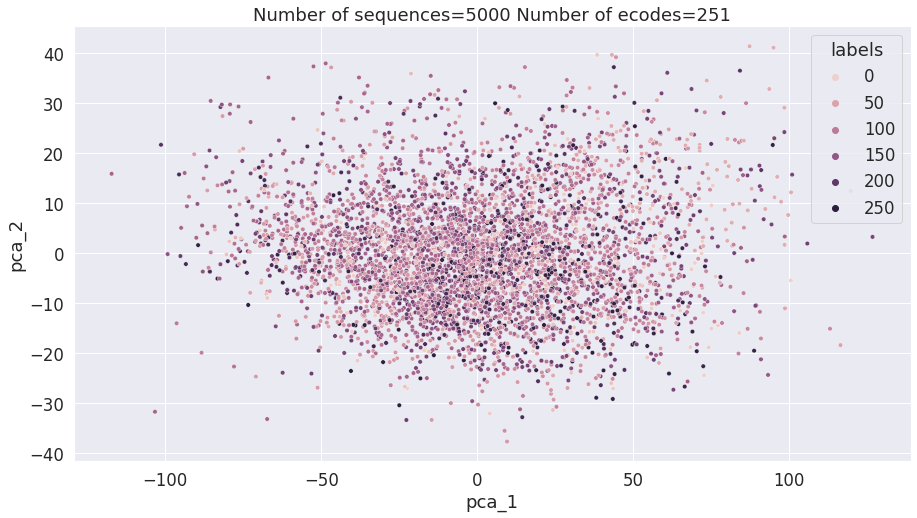

In [260]:
#fig, ax = plt.figure(1, figsize=(15, 15))
embeds_subset = all_gen_embeds[:5000,3,:] # 5000 mixed meanpooled embeddings of gen seqs (5000,768)

# get target ecodes of embedding subset which will be mapped to a dictionary
all_ecode_targets = list(train_ecode_set)
embeds_target_idxs = np.array([all_ecode_targets.index(seq.split()[1]) for seq in gen_dataset[:5000]]) # map ecode:int which will serve as target value for grouping clusters by
embeds_tgt_ecodes = [all_ecode_targets[idx] for idx in embeds_target_idxs] # ecode strings of the embeddings
#idx_label_dict = {idx:val for idx, val in enumerate(set(embeds_tgt_ecodes))}
idx_labels = [label for label in set(embeds_tgt_ecodes)]
embeds_targets = np.array([idx_labels.index(ecode) for ecode in [all_ecode_targets[idx] for idx in embeds_target_idxs]])

model_2D = PCA(n_components=2) # plot in 3D for now for initial visualization
model_95 = PCA(n_components=0.95,svd_solver='full') # n_components that explain variance >= 95% data
reduced_2D = model_2D.fit(embeds_subset).transform(embeds_subset)
reduced_095 = model_95.fit(embeds_subset).transform(embeds_subset)
print(reduced_095.shape) # (5000, 4) 4 dims explain >=95% variance

print(len(set(embeds_targets))) # 459
#ax.scatter(reduced_3D[:,0], reduced_3D[:,1], reduced_3D[:,2], c=embeds_targets, cmap=plt.cm.nipy_spectral, edgecolor="k", s=20)

fig, ax = plt.subplots()
pca_2D_df = pd.DataFrame({'pca_1':reduced_2D[:,0], 'pca_2':reduced_2D[:,1], 'labels':embeds_targets})
sns.scatterplot(x='pca_1', y='pca_2', hue='labels',data=pca_2D_df,s=20,ax=ax)
ax.set_title(f'Number of sequences=5000 Number of ecodes={len(set(embeds_targets))}')

### TSNE Plot

In [261]:
from sklearn.manifold import TSNE

# Test perplexity values
tsne_mod = TSNE(n_components=2,random_state=rstate, perplexity=30) # default perplexity value
tsne_res5k_30P = tsne_mod.fit_transform(embeds_subset[:5000])

tsne_testmod = TSNE(n_components=2,random_state=rstate,perplexity=5)
tsne_res5k_5P = tsne_testmod.fit_transform(embeds_subset[:5000])

tsne_testmod = TSNE(n_components=2,random_state=rstate,perplexity=50)
tsne_res5k_50P = tsne_testmod.fit_transform(embeds_subset[:5000])

Text(0.5, 1.0, 'Perplexity=5 Number of sequences=5000 Number of ecodes=251')

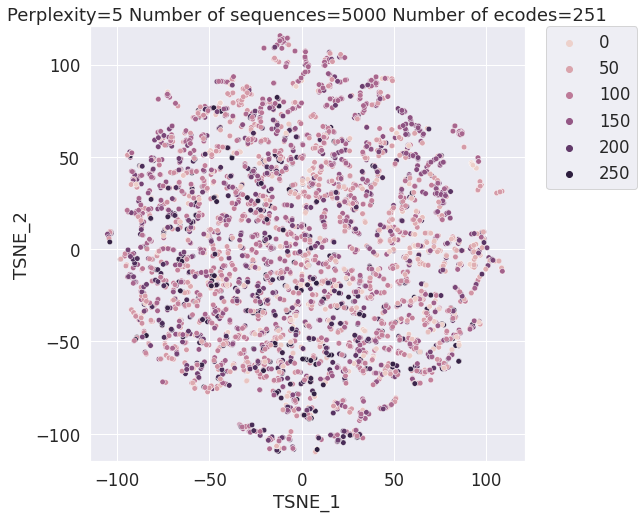

In [262]:
res5k_5P_df = pd.DataFrame({'TSNE_1':tsne_res5k_5P[:,0], 'TSNE_2':tsne_res5k_5P[:,1],'labels':embeds_targets[:5000]})
fig, ax = plt.subplots(1)
sns.scatterplot(x='TSNE_1',y='TSNE_2',hue='labels',data=res5k_5P_df,ax=ax,s=30)
lim = (tsne_res5k_5P.min()-5, tsne_res5k_5P.max()+5)
ax.set_xlim(lim)
ax.set_ylim(lim)
ax.set_aspect('equal')
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.0)
ax.set_title(f'Perplexity=5 Number of sequences=5000 Number of ecodes={len(set(embeds_targets))}')

Text(0.5, 1.0, 'Perplexity=30 Number of sequences=5000 Number of ecodes=251')

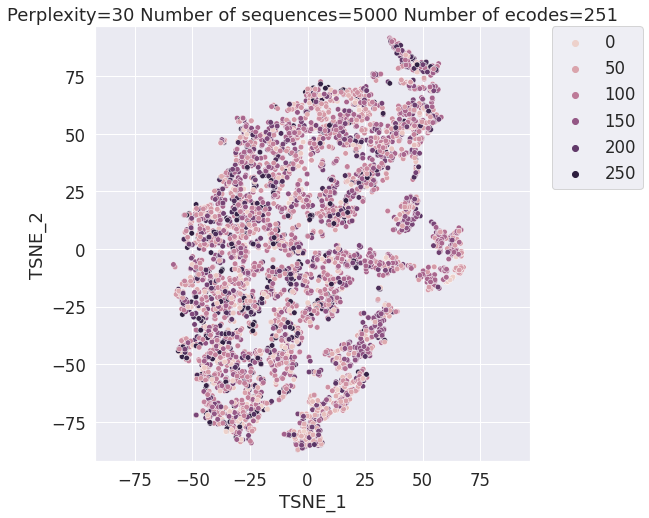

In [263]:
rstate = RandomState(MT19937(SeedSequence(12345)))
res5k_30P_df = pd.DataFrame({'TSNE_1':tsne_res5k_30P[:,0], 'TSNE_2':tsne_res5k_30P[:,1],'labels':embeds_targets[:5000]})
fig, ax = plt.subplots(1)
sns.scatterplot(x='TSNE_1',y='TSNE_2',hue='labels',data=res5k_30P_df,ax=ax,s=30)
lim = (tsne_res5k_30P.min()-5, tsne_res5k_30P.max()+5)
ax.set_xlim(lim)
ax.set_ylim(lim)
ax.set_aspect('equal')
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.0)
ax.set_title(f'Perplexity=30 Number of sequences=5000 Number of ecodes={len(set(embeds_targets))}')

Text(0.5, 1.0, 'Perplexity=50 Number of sequences=5000 Number of ecodes=251')

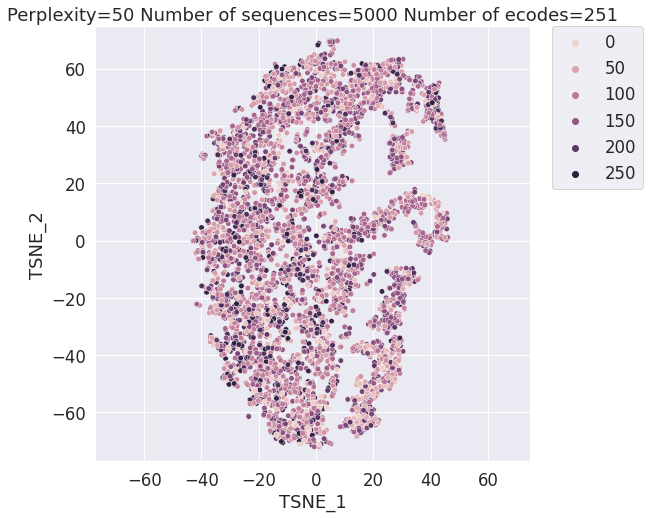

In [264]:
rstate = RandomState(MT19937(SeedSequence(1234)))
res5k_50P_df = pd.DataFrame({'TSNE_1':tsne_res5k_50P[:,0], 'TSNE_2':tsne_res5k_50P[:,1],'labels':embeds_targets[:5000]})
fig, ax = plt.subplots(1)
sns.scatterplot(x='TSNE_1',y='TSNE_2',hue='labels',data=res5k_50P_df,ax=ax,s=30)
lim = (tsne_res5k_50P.min()-5, tsne_res5k_50P.max()+5)
ax.set_xlim(lim)
ax.set_ylim(lim)
ax.set_aspect('equal')
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.0)
ax.set_title(f'Perplexity=50 Number of sequences=5000 Number of ecodes={len(set(embeds_targets))}')

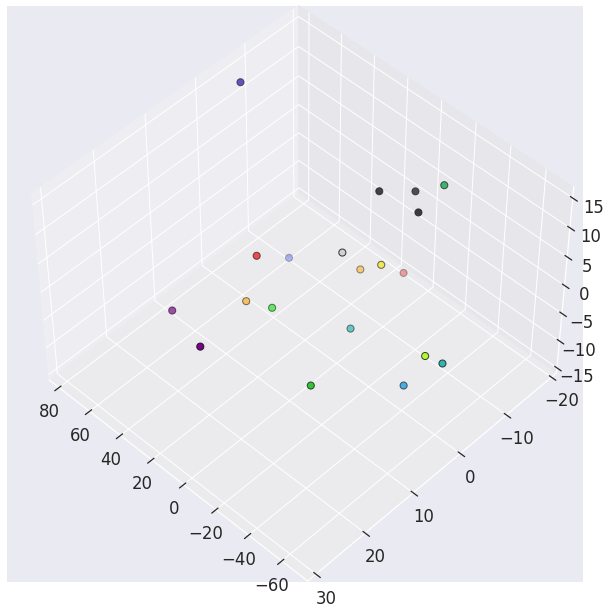

In [171]:
# random state and figure setup
rstate = RandomState(MT19937(SeedSequence(123456789)))
fig = plt.figure(1, figsize=(15, 8))
plt.clf()
ax = Axes3D(fig, rect=[0, 0, 0.95, 1], elev=48, azim=134)

embeds_subset = all_gen_embeds[:20,3,:] # 200 mixed meanpooled embeddings of gen seqs (200,768)

# get target ecodes of embedding subset which will be mapped to a dictionary
all_ecode_targets = list(train_ecode_set)
embeds_target_idxs = np.array([all_ecode_targets.index(seq.split()[1]) for seq in gen_dataset[:20]]) # map ecode:int which will serve as target value for grouping clusters by
embeds_tgt_ecodes = [all_ecode_targets[idx] for idx in embeds_target_idxs] # ecode strings of the embeddings
#idx_label_dict = {idx:val for idx, val in enumerate(set(embeds_tgt_ecodes))}
idx_labels = [label for label in set(embeds_tgt_ecodes)]
embeds_targets = np.array([idx_labels.index(ecode) for ecode in [all_ecode_targets[idx] for idx in embeds_target_idxs]])

model_3D = PCA(n_components=3) # plot in 3D for now for initial visualization
model_95 = PCA(n_components=0.95,svd_solver='full') # n_components that explain variance >= 95% data
reduced_3D = model_3D.fit(embeds_subset).transform(embeds_subset)

ax.scatter(reduced_3D[:,0], reduced_3D[:,1], reduced_3D[:,2], c=embeds_targets, s=50, cmap=plt.cm.nipy_spectral, edgecolor="k")

In [172]:
len(set(embeds_targets))

15

In [7]:
df = px.data.iris()
df

,sepal_length,sepal_width,petal_length,petal_width,species,species_id
0,5.1,3.5,1.4,0.2,setosa,1
1,4.9,3.0,1.4,0.2,setosa,1
2,4.7,3.2,1.3,0.2,setosa,1
3,4.6,3.1,1.5,0.2,setosa,1
4,5.0,3.6,1.4,0.2,setosa,1
...,...,...,...,...,...,...
145,6.7,3.0,5.2,2.3,virginica,3
146,6.3,2.5,5.0,1.9,virginica,3
147,6.5,3.0,5.2,2.0,virginica,3
148,6.2,3.4,5.4,2.3,virginica,3
